<a href="https://colab.research.google.com/github/aaryaapte/parkinsonsProgression/blob/main/SF3_Aarya_AllN_123.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install matplotlib-venn
!pip install ipympl
!pip install ace-tools
!pip install lime

import numpy as np
import pandas as pd
# %matplotlib widget
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.preprocessing import StandardScaler, MinMaxScaler, PolynomialFeatures
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import classification_report, mean_squared_error
from sklearn import svm, metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras.activations import relu,linear
from tensorflow.keras.datasets import mnist
from tensorflow.keras.losses import SparseCategoricalCrossentropy
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import to_categorical
# from google.colab import output
from tensorflow.keras.layers import Dense, Dropout


from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from sklearn.preprocessing import StandardScaler
from sklearn.utils.class_weight import compute_class_weight
from sklearn.preprocessing import LabelEncoder
from lime.lime_tabular import LimeTabularExplainer
import re
from tabulate import tabulate

from sklearn.tree import DecisionTreeRegressor, export_graphviz, plot_tree, export_text
import graphviz
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_absolute_error
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Dropout, Input, MultiHeadAttention, LayerNormalization, Add
from tensorflow.keras.optimizers import Adam
from IPython.display import display
from sklearn.preprocessing import MinMaxScaler

import logging
logging.getLogger("tensorflow").setLevel(logging.ERROR)

tf.keras.backend.set_floatx('float64')

tf.autograph.set_verbosity(0)

In [ ]:
#Load data and files


# Step 1: Load the dataset
#data_path = '/content/sample_data/PPMI_Clean_1_234_Curated_Data.csv'  # Update this to the correct file path
data_path = '/content/sample_data/PPMI_Clean_allN_plus123_Curated_Data.csv'  # Update this to the correct file path
# data_path = '/Users/ajayapte/ajay/aarya/PD/PPMI_Clean_allN_plus123_Curated_Data.csv'  # Update this to the correct file path
data = pd.read_csv(data_path)


# Keep only numeric columns
data = data.select_dtypes(include=['number'])


# Step 2: Separate features and target variables
target_columns = ['NHY_Y2', 'NHY_ON_Y2', 'updrs1_score_Y2', 'updrs2_score_Y2', 'updrs3_score_Y2',
                  'updrs3_score_on_Y2', 'NHY_Y3', 'NHY_ON_Y3', 'updrs1_score_Y3', 'updrs2_score_Y3',
                  'updrs3_score_Y3', 'updrs3_score_on_Y3', 'NHY_Y4', 'NHY_ON_Y4', 'updrs1_score_Y4',
                  'updrs2_score_Y4', 'updrs3_score_Y4', 'updrs3_score_on_Y4']

y = data[target_columns]
X = data.drop(columns=target_columns)

# Handle missing values
X = X.fillna(0)

# Step 3: handle drop, no_change, categorical and scalar columns separately
drop_columns = ['PATNO', 'quip']

no_change_columns = ['SEX', 'HISPLAT', 'ASHKJEW', 'AFICBERB', 'BASQUE', 'handed',
      'sym_tremor', 'sym_rigid', 'sym_brady', 'sym_posins', 'sym_other',
      'MCI_testscores', 'cogstate', 'quip_any', 'quip_gamble', 'quip_sex',
      'quip_buy', 'quip_eat', 'quip_hobby', 'quip_pund', 'quip_walk', 'td_pigd',
      'td_pigd_on', 'pm_adl_any', 'pm_fd_any', 'pm_auto_any', 'pm_cog_any',
      'pm_mc_any', 'pm_wb_any']

categorical_columns = ['COHORT', 'subgroup', 'race', 'fampd', 'APOE_e4', 'PRIMDIAG']

scalar_columns = ['YEAR', 'age',
        'BMI', 'agediag', 'ageonset',  'LEDD', 'moca', 'bjlot',
       'hvlt_discrimination', 'hvlt_immediaterecall', 'hvlt_retention',
       'HVLTFPRL', 'HVLTRDLY', 'HVLTREC', 'lns', 'SDMTOTAL', 'VLTANIM',
        'MSEADLG',   'ess', 'rem', 'gds', 'stai', 'stai_state',
       'stai_trait', 'scopa_gi', 'scopa_ur', 'scopa_cv', 'scopa_therm',
       'scopa_pm', 'scopa_sex', 'orthostasis', 'pigd', 'pigd_on', 'NHY', 'NHY_ON', 'updrs1_score',
       'updrs2_score', 'updrs3_score', 'updrs3_score_on']


X = X.drop(columns=drop_columns)
print(f"Initial Feature columns =  {X.columns.size}")
numeric_columns = X.columns.difference(categorical_columns).difference(no_change_columns)
print (f"No change cols={len(no_change_columns)} categorical_cols={len(categorical_columns)} Numeric cols = {numeric_columns.size}")

# fix categorical columns
X = pd.get_dummies(X, columns=categorical_columns, prefix=categorical_columns, dtype=int)
print(f"Expanded Feature columns =  {X.columns.size}")

# Step 3: Split the dataset into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


# Normalize the data
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# # Initialize MinMaxScaler
# scaler = MinMaxScaler()

# # Select numerical columns
# numerical_data_train = X_train[numeric_columns]
# numerical_data_test = X_test[numeric_columns]

# # Normalize the numerical data
# numerical_data_train_scaled = scaler.fit_transform(numerical_data_train)
# numerical_data_test_scaled = scaler.transform(numerical_data_test)

# # Convert scaled numerical data back to DataFrames to maintain column names
# numerical_data_train_scaled_df = pd.DataFrame(numerical_data_train_scaled, columns=numerical_data_train.columns, index=X_train.index)
# numerical_data_test_scaled_df = pd.DataFrame(numerical_data_test_scaled, columns=numerical_data_test.columns, index=X_test.index)

# # Combine the scaled numerical columns with the unaltered non-numerical columns
# X_train_scaled = pd.concat([numerical_data_train_scaled_df, X_train.drop(columns=numeric_columns)], axis=1)
# X_test_scaled = pd.concat([numerical_data_test_scaled_df, X_test.drop(columns=numeric_columns)], axis=1)


# aaa
# Convert scaled data back to a DataFrame to access column names
X_scaled_df = pd.DataFrame(X_train_scaled, columns=X_train.columns)
print(f"Final Feature columns =  {X_scaled_df.columns.size}")
# Print the first rows of the specified columns
# columns_to_print = ['age', 'race_1.0', 'race_2.0', 'age' , 'agediag', 'HISPLAT', 'updrs1_score', 'NHY', 'NHY_ON']  # Replace with actual column names
# print(X_df[columns_to_print].head(40))
# end aaa


Initial Feature columns =  74
No change cols=29 categorical_cols=6 Numeric cols = 39
Expanded Feature columns =  109
Final Feature columns =  109


In [ ]:

# # Calculate missing data percentage
# missing_data = data.isnull().sum()
# missing_percentage = (missing_data / len(data)) * 100

# # Filter out columns with no missing data and those with missing percentage <= 1
# missing_percentage = missing_percentage[missing_percentage > 1]

# # Plot pie chart
# plt.figure(figsize=(8, 8))
# plt.pie(missing_percentage,
#         autopct='%1.1f%%', startangle=140, colors=plt.cm.Paired.colors)
# plt.title("Percentage of Missing Data by Feature")
# # Add a legend instead of labels
# plt.legend(
#     labels=missing_percentage.index,
#     title="Features",
#     bbox_to_anchor=(1, 0.5),
#     loc="center left"
# )

# plt.show()


In [ ]:
# Model 1: Train Linear Regression
linear_model = LinearRegression()
linear_model.fit(X_train_scaled, y_train)
y_pred_linear = linear_model.predict(X_test_scaled)
mae_linear = [mean_absolute_error(y_test.iloc[:, i], y_pred_linear[:, i]) for i in range(18)]

In [ ]:
# Models 2 and 3 Kernel Regression
print(f'Start kernel Regression')

kernel_model_deg2 = Pipeline([
    ('poly', PolynomialFeatures(degree=2)),
    ('linear', LinearRegression())
])
kernel_model_deg2.fit(X_train_scaled, y_train)
y_pred_kernel_deg2 = kernel_model_deg2.predict(X_test_scaled)
mae_kernel_deg2 = [mean_absolute_error(y_test.iloc[:, i], y_pred_kernel_deg2[:, i]) for i in range(18)]
print(f'finished kernel Regression deg2')

# # Step 6: Train Kernel Regression (Polynomial Degree 3)
# kernel_model_deg3 = Pipeline([
#     ('poly', PolynomialFeatures(degree=3)),
#     ('linear', LinearRegression())
# ])
# kernel_model_deg3.fit(X_train_scaled, y_train)
# y_pred_kernel_deg3 = kernel_model_deg3.predict(X_test_scaled)
# mae_kernel_deg3 = [mean_absolute_error(y_test.iloc[:, i], y_pred_kernel_deg3[:, i]) for i in range(18)]
# print(f'finished kernel Regression deg3')


Start kernel Regression
finished kernel Regression deg2


In [ ]:
#Simple neural network
model = Sequential([
    Dense(64, activation='relu', input_shape=(X_train_scaled.shape[1],)),
    Dense(128, activation='relu'),
    Dense(256, activation='relu'),
    Dense(128, activation='relu'),
    Dense(64, activation='relu'),
    Dense(18)  # Output layer for 18 target variables
])

model.compile(optimizer='adam', loss='mse', metrics=['mae'])
model.fit(X_train_scaled, y_train, validation_split=0.2, epochs=200, batch_size=16, verbose=1)
y_pred_nn = model.predict(X_test_scaled)
mae_nn = [mean_absolute_error(y_test.iloc[:, i], y_pred_nn[:, i]) for i in range(18)]


Epoch 1/200


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


211/211 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - loss: 92.0049 - mae: 5.5989 - val_loss: 36.7579 - val_mae: 3.3016
Epoch 2/200
211/211 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 30.9591 - mae: 3.2378 - val_loss: 30.2877 - val_mae: 3.1410
Epoch 3/200
211/211 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 28.5265 - mae: 3.0301 - val_loss: 32.1910 - val_mae: 3.1262
Epoch 4/200
211/211 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 28.0947 - mae: 2.9853 - val_loss: 33.8817 - val_mae: 3.0989
Epoch 5/200
211/211 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - loss: 27.5940 - mae: 2.9431 - val_loss: 28.6297 - val_mae: 2.9709
Epoch 6/200
211/211 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 26.0019 - mae: 2.8352 - val_loss: 28.7301 - val_mae: 2.9797
Epoch 7/200
211/211 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 26.4043 - mae: 2.8629 - val_loss: 30.1304 - val_mae: 2.9729
Epoch 8/200
211/211 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 24.9751 - mae: 2.7789 - val_loss: 27.9695 - val_mae: 2.9303
Epoch 9/200
211/211 ━━━━━━━━━━━━━━━━━━━━ 1s 

In [ ]:
# Ridge Regression, Random Forest and Gradient Boosting
from sklearn.multioutput import MultiOutputRegressor

# Ridge Regression with MultiOutputRegressor
ridge_model = MultiOutputRegressor(Ridge(alpha=1.0))
ridge_model.fit(X_train_scaled, y_train)
y_pred_ridge = ridge_model.predict(X_test_scaled)
mae_ridge = [mean_absolute_error(y_test.iloc[:, i], y_pred_ridge[:, i]) for i in range(18)]
print(f'Finished Ridge Regression')

# Random Forest Regressor with MultiOutputRegressor
rf_model = MultiOutputRegressor(RandomForestRegressor(n_estimators=100, random_state=42))
rf_model.fit(X_train_scaled, y_train)
y_pred_rf = rf_model.predict(X_test_scaled)
mae_rf = [mean_absolute_error(y_test.iloc[:, i], y_pred_rf[:, i]) for i in range(18)]
print(f'Finished Random Forest')

# for output_index, model in enumerate(rf_model.estimators_):
#     # Loop through the individual trees of the RandomForestRegressor
#     for tree_index, tree in enumerate(model.estimators_):
#         depth = tree.get_depth()  # Get the maximum depth of the tree
#         print(f"Depth of tree {tree_index} for output {output_index} is {depth}")

# Gradient Boosting Regressor with MultiOutputRegressor
gb_model = MultiOutputRegressor(GradientBoostingRegressor(n_estimators=100, random_state=42))
gb_model.fit(X_train_scaled, y_train)
y_pred_gb = gb_model.predict(X_test_scaled)
mae_gb = [mean_absolute_error(y_test.iloc[:, i], y_pred_gb[:, i]) for i in range(18)]
print(f'Finished Gradient Boosting')


Finished Ridge Regression
Finished Random Forest
Finished Gradient Boosting


In [ ]:
# A simple transformer model
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Dropout, Input, MultiHeadAttention, LayerNormalization, Add, Reshape

def build_transformer_model(input_dim, output_dim):
    inputs = Input(shape=(input_dim,))
    # Reshape the input for MultiHeadAttention: (batch_size, 1, input_dim)
    reshaped_inputs = Reshape((1, input_dim))(inputs)

    # Multi-Head Attention
    attn_output = MultiHeadAttention(num_heads=4, key_dim=input_dim)(reshaped_inputs, reshaped_inputs)
    attn_output = Add()([reshaped_inputs, attn_output])
    x = LayerNormalization()(attn_output)

    # Flatten back to (batch_size, input_dim)
    x = Reshape((input_dim,))(x)

    # Fully Connected Layers
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.3)(x)
    outputs = Dense(output_dim)(x)

    model = Model(inputs, outputs)
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse', metrics=['mae'])
    return model

# Build and train the Transformer model
transformer_model = build_transformer_model(X_train_scaled.shape[1], y_train.shape[1])
transformer_model.fit(X_train_scaled, y_train, validation_split=0.2, epochs=50, batch_size=32, verbose=1)

# Predict and calculate MAE for Transformer model
y_pred_transformer = transformer_model.predict(X_test_scaled)
mae_transformer = [mean_absolute_error(y_test.iloc[:, i], y_pred_transformer[:, i]) for i in range(18)]


Epoch 1/50
106/106 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - loss: 133.8419 - mae: 6.7376 - val_loss: 41.5880 - val_mae: 3.6008
Epoch 2/50
106/106 ━━━━━━━━━━━━━━━━━━━━ 3s 29ms/step - loss: 39.7966 - mae: 3.8380 - val_loss: 33.1452 - val_mae: 3.2555
Epoch 3/50
106/106 ━━━━━━━━━━━━━━━━━━━━ 4s 36ms/step - loss: 37.6805 - mae: 3.6450 - val_loss: 31.8017 - val_mae: 3.1846
Epoch 4/50
106/106 ━━━━━━━━━━━━━━━━━━━━ 4s 27ms/step - loss: 36.2143 - mae: 3.5401 - val_loss: 31.1400 - val_mae: 3.1885
Epoch 5/50
106/106 ━━━━━━━━━━━━━━━━━━━━ 3s 28ms/step - loss: 32.4543 - mae: 3.2925 - val_loss: 30.6978 - val_mae: 3.1291
Epoch 6/50
106/106 ━━━━━━━━━━━━━━━━━━━━ 6s 36ms/step - loss: 29.9740 - mae: 3.1129 - val_loss: 30.0037 - val_mae: 2.9877
Epoch 7/50
106/106 ━━━━━━━━━━━━━━━━━━━━ 5s 30ms/step - loss: 31.1409 - mae: 3.1716 - val_loss: 31.4807 - val_mae: 3.1551
Epoch 8/50
106/106 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - loss: 30.8218 - mae: 3.1479 - val_loss: 33.3142 - val_mae: 3.0632
Epoch 9/50
106/106 ━━━━━━━━━━━━

In [ ]:
# from tensorflow.keras.models import Sequential
# from tensorflow.keras.layers import Dense, Dropout, Input, Add

def build_residual_nn(input_dim, output_dim):
    inputs = Input(shape=(input_dim,))
    x = Dense(64, activation='relu')(inputs)
    residual = x  # Save for residual connection
    x = Dropout(0.3)(x)
    x = Dense(64, activation='relu')(x)
    x = Add()([x, residual])  # Residual connection
    x = Dropout(0.3)(x)
    outputs = Dense(output_dim)(x)
    model = Model(inputs, outputs)
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse', metrics=['mae'])
    return model

residual_nn_model = build_residual_nn(X_train_scaled.shape[1], y_train.shape[1])
residual_nn_model.fit(X_train_scaled, y_train, validation_split=0.2, epochs=50, batch_size=32, verbose=1)
y_pred_residual_nn = residual_nn_model.predict(X_test_scaled)
mae_residual_nn = [mean_absolute_error(y_test.iloc[:, i], y_pred_residual_nn[:, i]) for i in range(18)]

Epoch 1/50
106/106 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 139.4480 - mae: 6.8992 - val_loss: 46.9028 - val_mae: 4.0055
Epoch 2/50
106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 45.3931 - mae: 4.1842 - val_loss: 38.8401 - val_mae: 3.4770
Epoch 3/50
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 40.6346 - mae: 3.7831 - val_loss: 37.2350 - val_mae: 3.3641
Epoch 4/50
106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 37.9475 - mae: 3.6106 - val_loss: 33.5689 - val_mae: 3.3085
Epoch 5/50
106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 35.2330 - mae: 3.4595 - val_loss: 34.4881 - val_mae: 3.2589
Epoch 6/50
106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 33.5097 - mae: 3.3452 - val_loss: 32.3145 - val_mae: 3.2037
Epoch 7/50
106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 32.5158 - mae: 3.2705 - val_loss: 32.3721 - val_mae: 3.1746
Epoch 8/50
106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 32.2397 - mae: 3.2334 - val_loss: 31.0850 - val_mae: 3.1394
Epoch 9/50
106/106 ━━━━━━━━━━━━━━━━━━━━

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, MultiHeadAttention, LayerNormalization, Add, Reshape

def build_fixed_transformer(input_dim, output_dim):
    """
    Builds a fixed advanced Transformer model with consistent tensor shapes for MultiHeadAttention.
    """
    inputs = Input(shape=(input_dim,))

    # Reshape for Multi-Head Attention
    reshaped_inputs = Reshape((1, input_dim))(inputs)  # Reshape to 3D: (batch_size, seq_len=1, input_dim)

    # Multi-Head Attention Block 1
    attn_output = MultiHeadAttention(num_heads=4, key_dim=32)(reshaped_inputs, reshaped_inputs)
    attn_output = Add()([reshaped_inputs, attn_output])  # Residual Connection
    x = LayerNormalization()(attn_output)

    # Flatten back to 2D
    x = Reshape((input_dim,))(x)

    # Fully Connected Dense Block
    x = Dense(256, activation='relu')(x)
    x = Dropout(0.3)(x)

    # Fully Connected Dense Block 2
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.3)(x)

    # Final Output Layer
    outputs = Dense(output_dim)(x)

    # Compile the Model
    model = Model(inputs, outputs)
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse', metrics=['mae'])
    return model

# Build and train the corrected model
corrected_transformer_model = build_fixed_transformer(input_dim=X_train_scaled.shape[1], output_dim=y_train.shape[1])
history = corrected_transformer_model.fit(X_train_scaled, y_train, validation_split=0.2, epochs=100, batch_size=32, verbose=1)

# Predict and evaluate
y_pred_corrected_transformer = corrected_transformer_model.predict(X_test_scaled)
mae_corrected_transformer = [mean_absolute_error(y_test.iloc[:, i], y_pred_corrected_transformer[:, i]) for i in range(18)]


Epoch 1/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 5s 15ms/step - loss: 98.2757 - mae: 5.8462 - val_loss: 34.2944 - val_mae: 3.3588
Epoch 2/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 36.8681 - mae: 3.7108 - val_loss: 32.0220 - val_mae: 3.2680
Epoch 3/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - loss: 33.3748 - mae: 3.4517 - val_loss: 30.0301 - val_mae: 3.0892
Epoch 4/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - loss: 29.8078 - mae: 3.1996 - val_loss: 29.9535 - val_mae: 3.0362
Epoch 5/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 29.8880 - mae: 3.1985 - val_loss: 28.0643 - val_mae: 2.9314
Epoch 6/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 30.8025 - mae: 3.1882 - val_loss: 27.9223 - val_mae: 2.9126
Epoch 7/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - loss: 27.8473 - mae: 3.0144 - val_loss: 28.2707 - val_mae: 3.0083
Epoch 8/100
106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 28.1645 - mae: 3.0199 - val_loss: 29.3652 - val_mae: 2.9199
Epoch 9/100
106/106 ━━━━

In [ ]:
# Compile Results into a Table
output_names = ["NHY_Y2", "NHY_ON_Y2", "updrs1_score_Y2", "updrs2_score_Y2", "updrs3_score_Y2", "updrs3_score_on_Y2",
                "NHY_Y3", "NHY_ON_Y3", "updrs1_score_Y3", "updrs2_score_Y3", "updrs3_score_Y3", "updrs3_score_on_Y3",
                "NHY_Y4", "NHY_ON_Y4", "updrs1_score_Y4", "updrs2_score_Y4", "updrs3_score_Y4", "updrs3_score_on_Y3"]
results = pd.DataFrame({
    # "Output Variable": [f"Y{i+1}" for i in range(18)],
    "Output Variable": output_names,
    "Linear Regression": mae_linear,
    "Kernel Regression": mae_kernel_deg2,
    # "Kernel Regression (Deg 3)": mae_kernel_deg3,
    "Neural Network": mae_nn,
    "Ridge Regression": mae_ridge,
    "Random Forest": mae_rf,
    "Gradient Boosting": mae_gb,
    "Transformer": mae_transformer,
    "Residual NN": mae_residual_nn,
    "Advanced Transformer": mae_corrected_transformer
})

# results = pd.DataFrame({
#     "Output Variable": [f"Y{i+1}" for i in range(18)],
#     "Linear Regression": mae_linear,
#     "Ridge Regression": mae_ridge,
#     "Random Forest": mae_rf,
#     "Gradient Boosting": mae_gb
# })
# Display the results
display(results)

,Output Variable,Linear Regression,Kernel Regression,Neural Network,Ridge Regression,Random Forest,Gradient Boosting,Transformer,Residual NN,Advanced Transformer
0,NHY_Y2,0.207107,3.433903,0.308243,0.206828,0.195782,0.196227,0.334989,0.311867,0.332754
1,NHY_ON_Y2,0.211909,3.226655,0.329924,0.211715,0.201223,0.199321,0.329235,0.312832,0.332656
2,updrs1_score_Y2,2.364879,23.762784,3.054783,2.364098,2.347052,2.377298,2.494156,2.587756,2.470379
3,updrs2_score_Y2,1.956644,16.100298,2.559245,1.962543,1.944929,1.923465,2.186018,2.162319,2.057785
4,updrs3_score_Y2,4.807245,48.575156,5.786204,4.811897,4.873185,4.810353,4.927926,4.889797,4.880578
5,updrs3_score_on_Y2,4.411302,44.221485,5.421419,4.418086,4.489507,4.355721,4.532397,4.568307,4.473903
6,NHY_Y3,0.241471,1.678865,0.308061,0.240907,0.226237,0.224059,0.364553,0.341344,0.359642
7,NHY_ON_Y3,0.238803,1.460346,0.301330,0.238263,0.220104,0.225978,0.357511,0.339263,0.354725
8,updrs1_score_Y3,2.674349,19.151970,3.183844,2.676007,2.669829,2.673224,2.730533,2.796802,2.718126
9,updrs2_score_Y3,2.314217,24.168639,2.784293,2.324723,2.219488,2.212072,2.403310,2.423446,2.321605


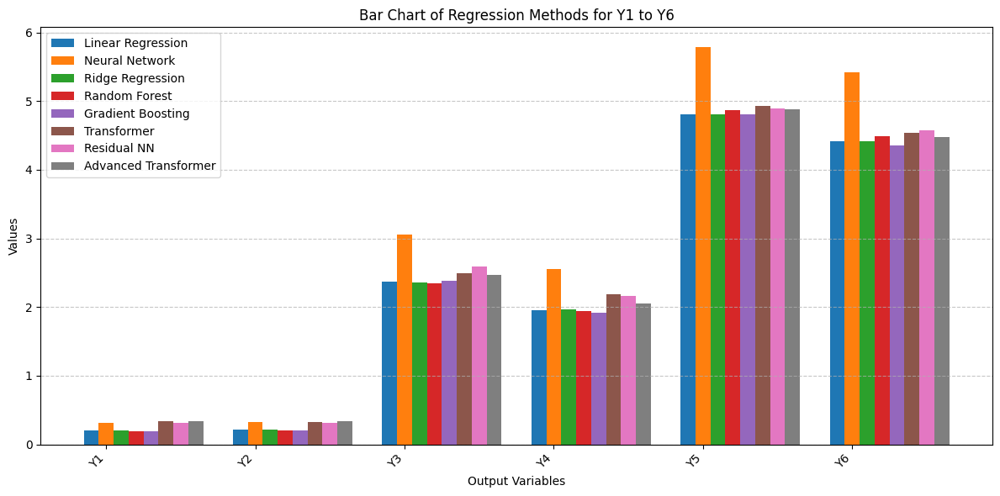

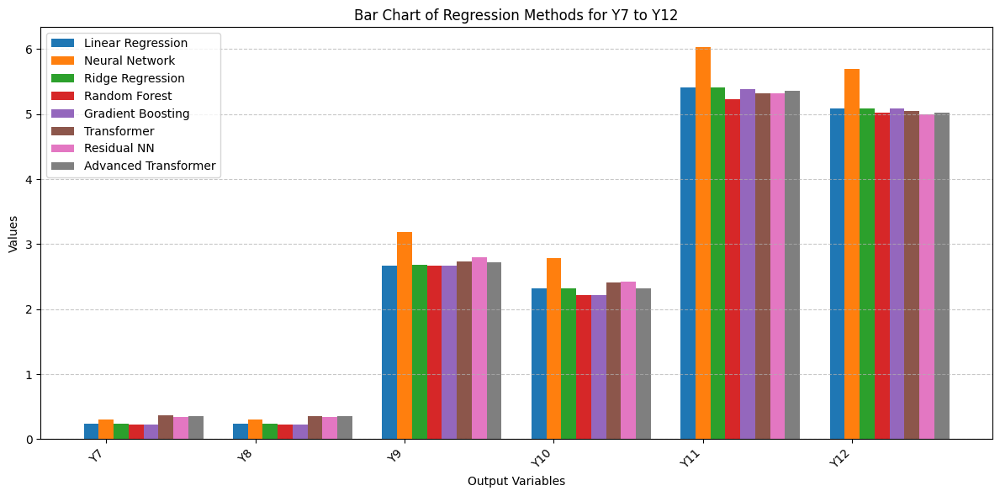

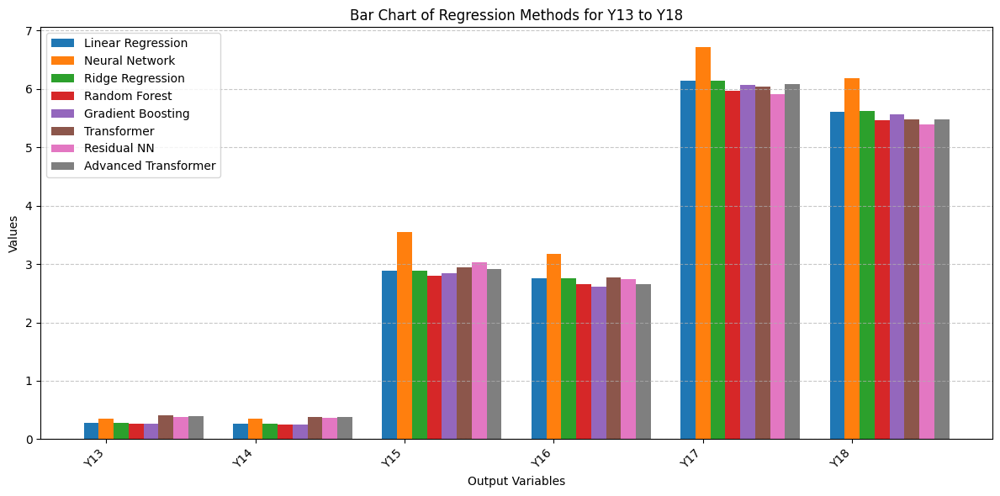

In [ ]:
#from google.colab import output
#output.enable_custom_widget_manager()
from matplotlib import pyplot as plt
%matplotlib inline
plt.close()
plt.rcParams['figure.max_open_warning'] = 100

subsets = [
    results[results["Output Variable"].isin([f"Y{i}" for i in range(1, 7)])],
    results[results["Output Variable"].isin([f"Y{i}" for i in range(7, 13)])],
    results[results["Output Variable"].isin([f"Y{i}" for i in range(13, 19)])]
]

# Plot each subset
methods = ["Linear Regression", "Neural Network",
           "Ridge Regression", "Random Forest", "Gradient Boosting",
           "Transformer", "Residual NN", "Advanced Transformer"]
# methods = ["Linear Regression", "Kernel Regression (Deg 2)", "Neural Network",
#            "Ridge Regression", "Random Forest", "Gradient Boosting",
#            "Transformer", "Residual NN", "Advanced Transformer"]
# methods = ["Linear Regression",
#            "Ridge Regression", "Random Forest", "Gradient Boosting"
#            ]
bar_width = 0.1  # Width of each bar

for idx, subset in enumerate(subsets):
    x_labels = subset["Output Variable"]  # X-axis labels
    x = np.arange(len(x_labels))  # Positions for each Y label

    plt.figure(figsize=(12, 6))
    for i, method in enumerate(methods):
        plt.bar(x + i * bar_width, subset[method], width=bar_width, label=method)

    # Customizing the plot
    plt.xlabel("Output Variables")
    plt.ylabel("Values")
    plt.title(f"Bar Chart of Regression Methods for {x_labels.iloc[0]} to {x_labels.iloc[-1]}")
    plt.xticks(x + bar_width, x_labels, rotation=45, ha="right")  # Rotate labels for better visibility
    plt.legend()
    plt.grid(axis='y', linestyle='--', alpha=0.7)

    # Set custom y-axis ticks with a step of 0.1
    y_min = 0  # Minimum value for the y-axis
    y_max = subset[methods].max().max() + 0.5  # Maximum value with a small margin
    plt.yticks(np.arange(y_min, y_max, 1))  # Custom ticks from y_min to y_max with step 0.1

    plt.tight_layout()
    plt.show()

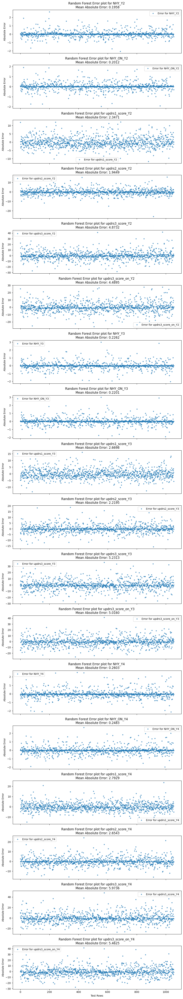

In [ ]:
# plot the error for each label

# Compute absolute errors for all test rows and target labels
absolute_errors = y_test.values - y_pred_rf

# Plot the errors for each target label
num_labels = len(y_train.columns)  # Number of target labels
fig, axes = plt.subplots(nrows=num_labels, figsize=(10, 3 * num_labels), sharex=True)

for i, target_name in enumerate(y_train.columns):
    ax = axes[i] if num_labels > 1 else axes
    ax.plot(absolute_errors[:, i], marker='o', linestyle='', markersize=3, alpha=0.7, label=f'Error for {target_name}')
    ax.set_ylabel('Absolute Error')
    ax.set_title(f'Random Forest Error plot for {target_name} \n Mean Absolute Error: {mae_rf[i]:.4f}')
    ax.legend()

plt.xlabel('Test Rows')
plt.tight_layout()
plt.show()

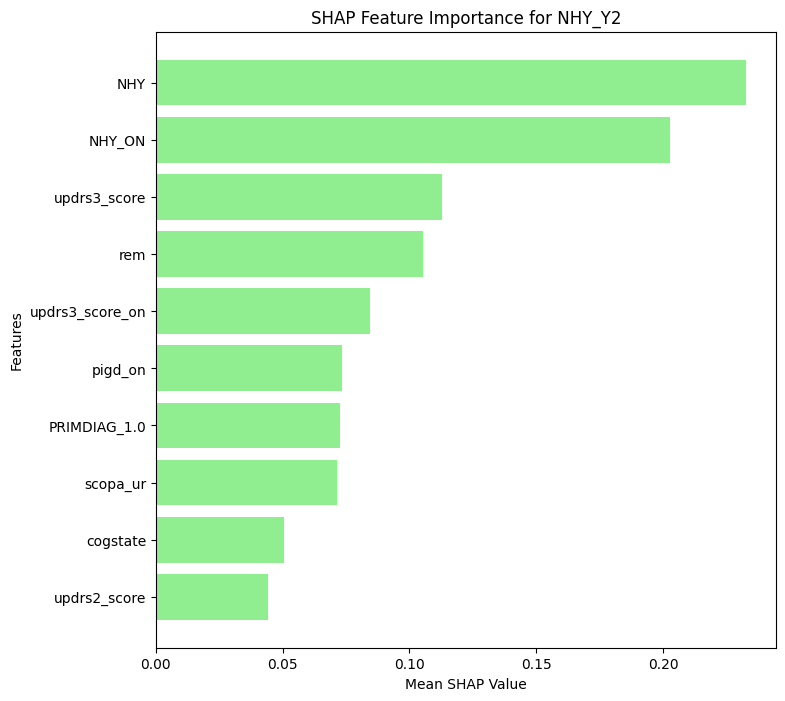

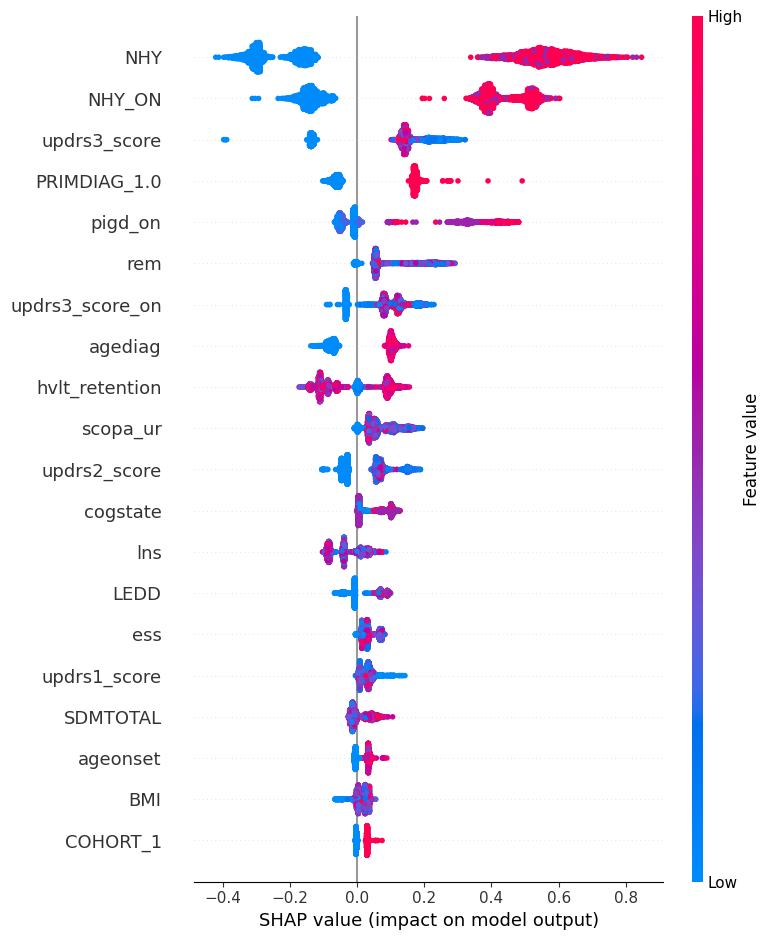

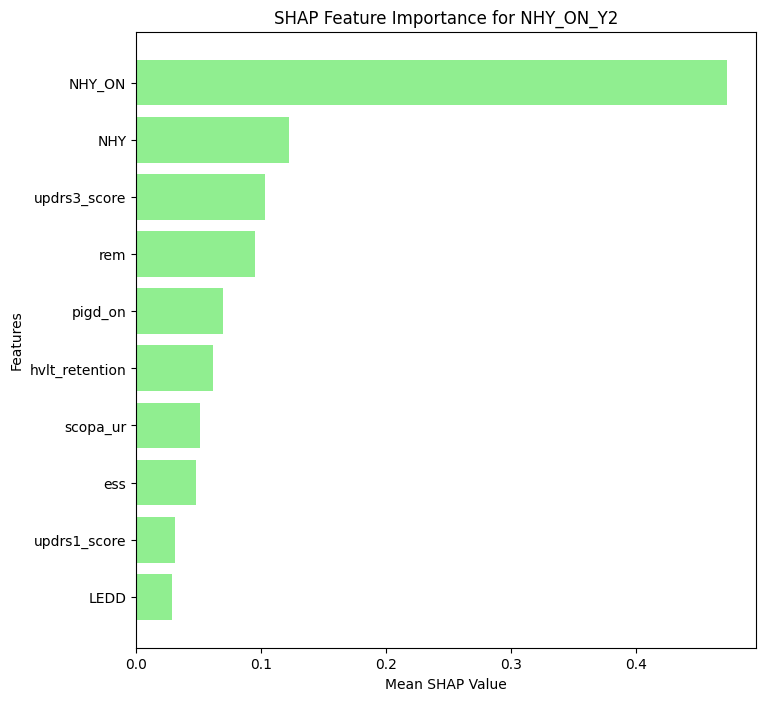

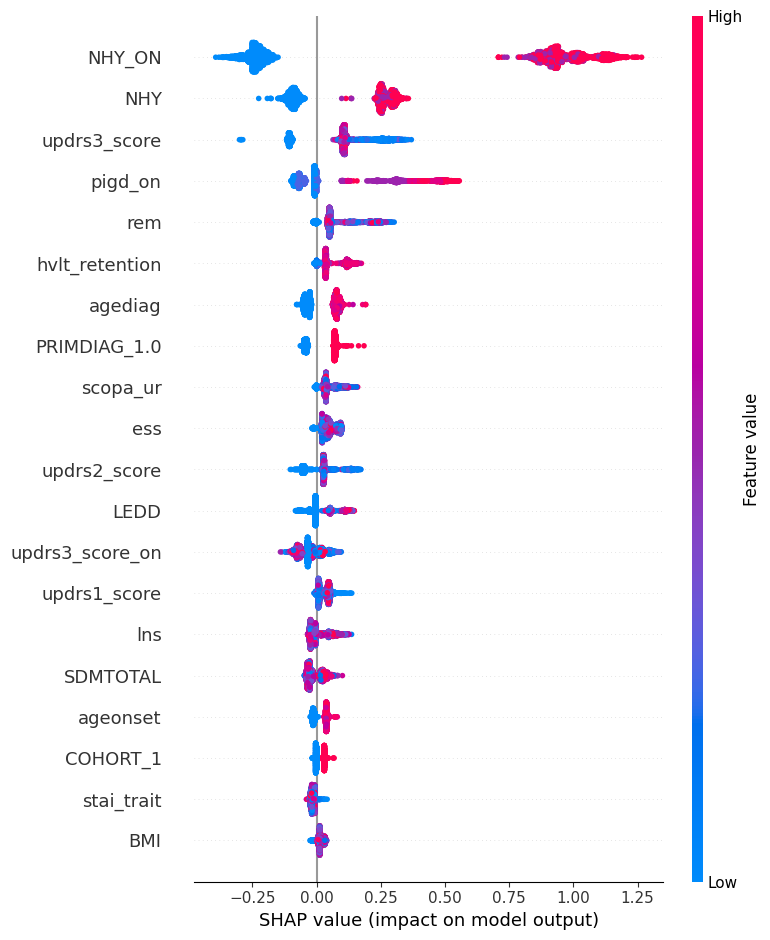

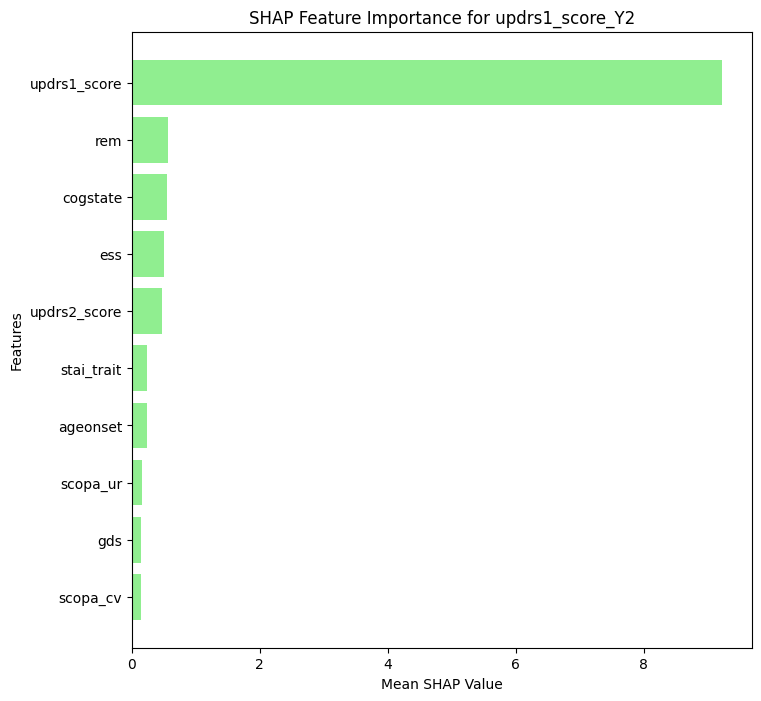

...

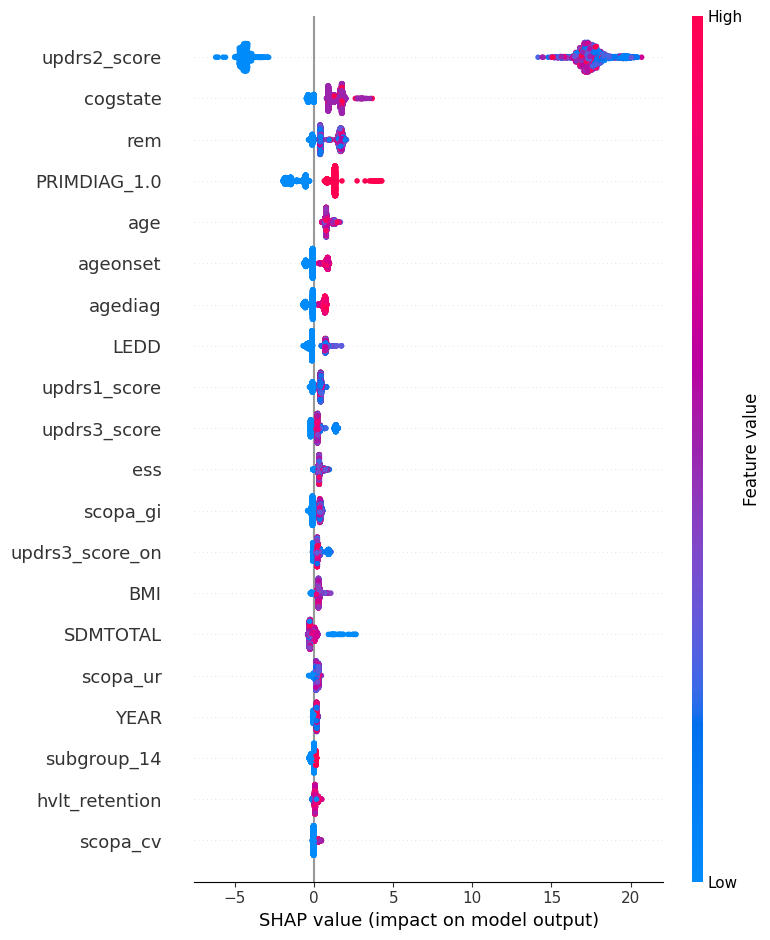

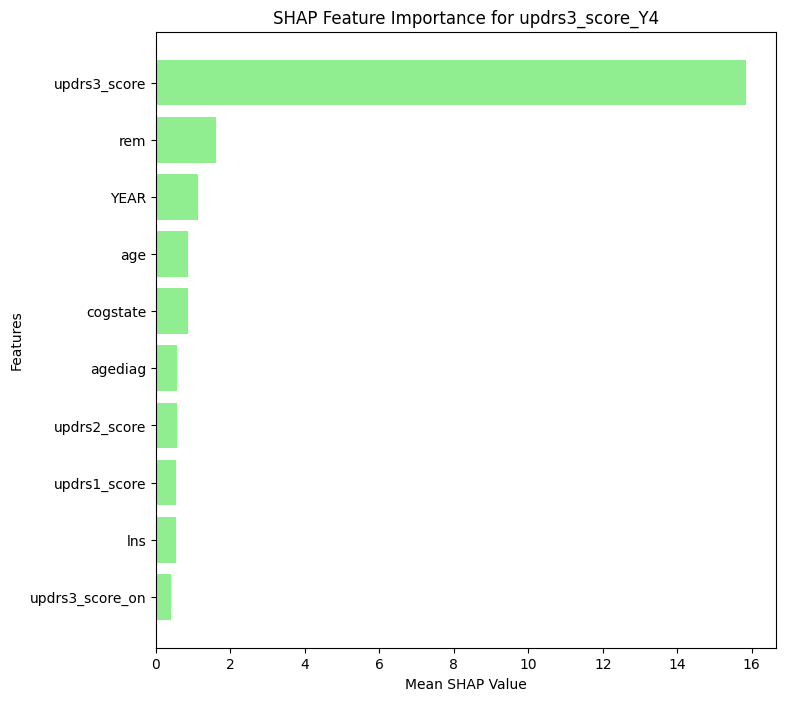

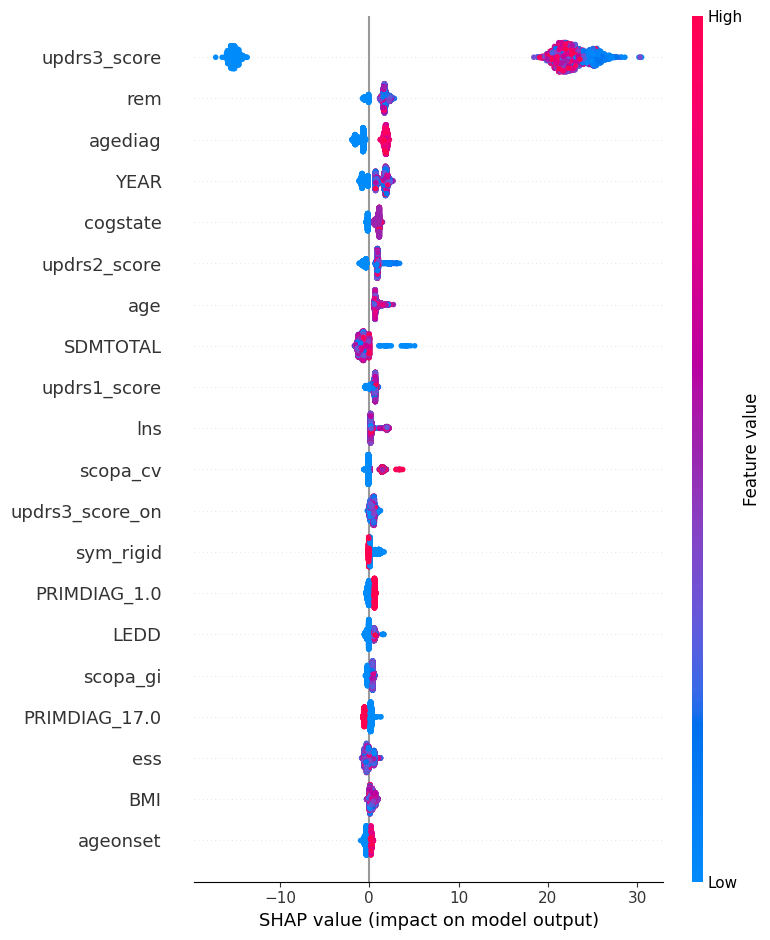

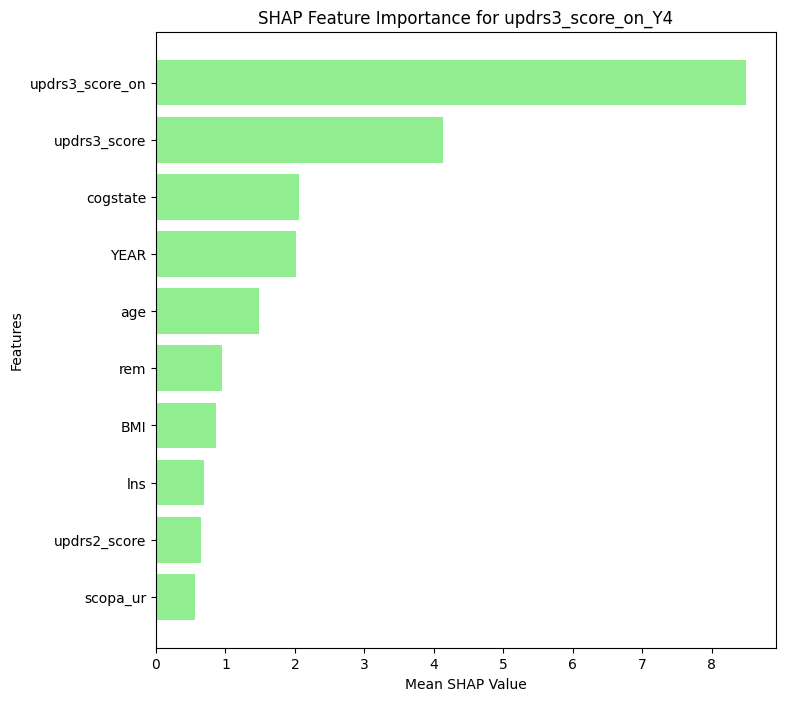

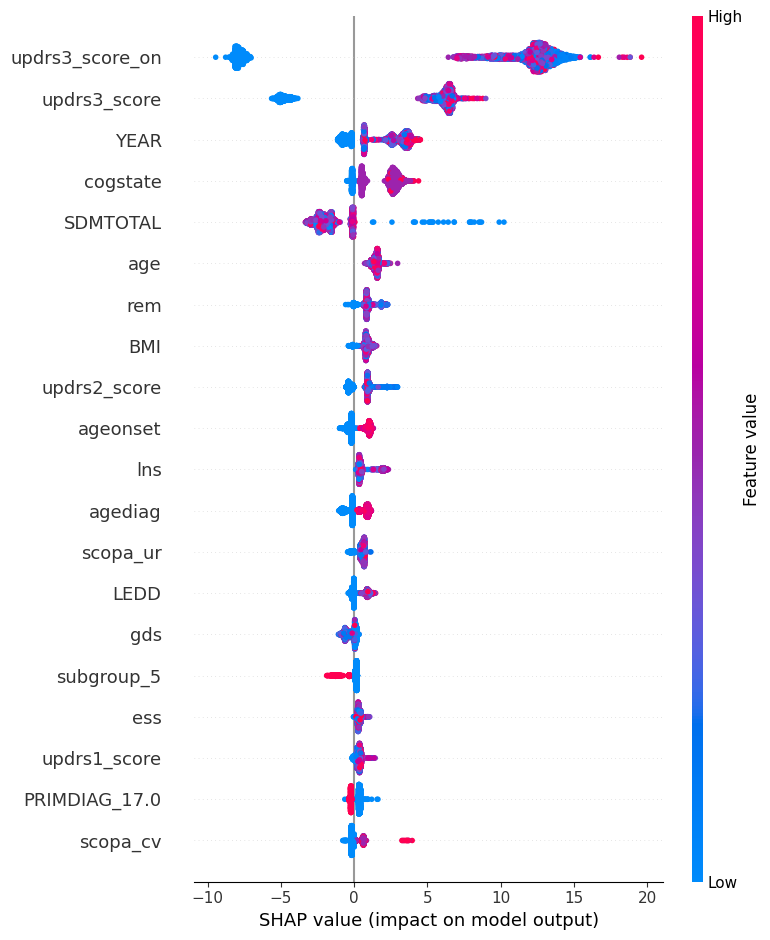

In [ ]:
!pip install shap

import shap
from collections import Counter

# Initialize a Counter to keep track of feature appearances
feature_counter = Counter()

# Loop through each target and apply SHAP for each individual regressor
for i, target_name in enumerate(y_train.columns):

    # Access the regressor for the current target
    regressor = rf_model.estimators_[i]

    # Create SHAP explainer for this individual regressor (Random Forest model)
    explainer = shap.TreeExplainer(regressor)

    # Get SHAP values for the current regressor and target
    shap_values = explainer.shap_values(X_train)

    # Create a DataFrame for visualization
    shap_df = pd.DataFrame({
        'Feature': X_train.columns,
        'SHAP Value': shap_values.mean(axis=0)  # Take mean SHAP value per feature
    }).sort_values(by='SHAP Value', ascending=False)

    shap_df = shap_df.head(10)  # Get top 10 most important features
    top_10_features = shap_df['Feature'].head(10).tolist()
    feature_counter.update(top_10_features)

    # Plot SHAP feature importance
    plt.figure(figsize=(8, 8))
    plt.barh(shap_df['Feature'], shap_df['SHAP Value'], color='lightgreen')
    plt.xlabel('Mean SHAP Value')
    plt.ylabel('Features')
    plt.title(f'SHAP Feature Importance for {target_name}')
    plt.gca().invert_yaxis()  # Flip for better visualization
    plt.show()

    # Optionally, plot the SHAP summary plot for more insight into feature contributions
    shap.summary_plot(shap_values, X_train)


In [ ]:
# Prep work for LIME

total_counts = sum(feature_counter.values())
print(f'Total count = {total_counts}')
# Print the result
print(f"features that appear top 10 SHAP values across all labels: {len(feature_counter)}")
for feature, count in feature_counter.items():
    print(f"{feature}: {count} times")

selected_features = list(feature_counter.keys())
selected_indices = [X_train.columns.get_loc(feat) for feat in selected_features if feat in X_train.columns]

# create input x_train and x_test with only selected columns
X_train_scaled_selected = X_train_scaled[:, selected_indices]
X_test_scaled_selected = X_test_scaled[:, selected_indices]
X_combined_scaled_selected = np.vstack((X_train_scaled_selected, X_test_scaled_selected))
total_features = X_train_scaled.shape[1]

print('\n\n')
print(f"X_train_scaled: {X_train_scaled.shape} -- X_train_scaled_eelected: {X_train_scaled_selected.shape}")
print(f"X_test_scaled: {X_test_scaled.shape} -- X_test_scaled_selected: {X_test_scaled_selected.shape}")
print(f"X_combined_scaled_selected: {X_combined_scaled_selected.shape}")
print(f"Total Features: {total_features}")

# Random Forest Regressor with MultiOutputRegressor
sel_rf_model = MultiOutputRegressor(RandomForestRegressor(n_estimators=100, random_state=42))
sel_rf_model.fit(X_train_scaled_selected, y_train)
sel_y_pred_rf = sel_rf_model.predict(X_test_scaled_selected)
sel_mae_rf = [mean_absolute_error(y_test.iloc[:, i], sel_y_pred_rf[:, i]) for i in range(18)]
print(f'Finished Selected Random Forest')

results = pd.DataFrame({
    "Output Variable": [f"Y{i+1}" for i in range(18)],
    "Linear Regression": mae_linear,
    "Ridge Regression": mae_ridge,
    "Random Forest": mae_rf,
    "Selected Random Forest": sel_mae_rf,
    "Gradient Boosting": mae_gb
})
# Display the results
display(results)

Total count = 180
features that appear top 10 SHAP values across all labels: 29
NHY: 7 times
NHY_ON: 6 times
updrs3_score: 14 times
rem: 18 times
updrs3_score_on: 10 times
pigd_on: 5 times
PRIMDIAG_1.0: 5 times
scopa_ur: 9 times
cogstate: 11 times
updrs2_score: 15 times
hvlt_retention: 4 times
ess: 7 times
updrs1_score: 12 times
LEDD: 2 times
stai_trait: 1 times
ageonset: 5 times
gds: 3 times
scopa_cv: 1 times
pigd: 2 times
hvlt_immediaterecall: 1 times
age: 12 times
BMI: 9 times
YEAR: 5 times
lns: 4 times
sym_rigid: 1 times
scopa_gi: 4 times
agediag: 5 times
stai: 1 times
HVLTFPRL: 1 times



X_train_scaled: (4217, 109) -- X_train_scaled_eelected: (4217, 29)
X_test_scaled: (1055, 109) -- X_test_scaled_selected: (1055, 29)
X_combined_scaled_selected: (5272, 29)
Total Features: 109
Finished Selected Random Forest


,Output Variable,Linear Regression,Ridge Regression,Random Forest,Selected Random Forest,Gradient Boosting
0,Y1,0.207107,0.206828,0.195782,0.197081,0.196227
1,Y2,0.211909,0.211715,0.201223,0.198882,0.199321
2,Y3,2.364879,2.364098,2.347052,2.378038,2.377298
3,Y4,1.956644,1.962543,1.944929,1.964417,1.923465
4,Y5,4.807245,4.811897,4.873185,4.851507,4.810353
5,Y6,4.411302,4.418086,4.489507,4.449592,4.355721
6,Y7,0.241471,0.240907,0.226237,0.225706,0.224059
7,Y8,0.238803,0.238263,0.220104,0.222863,0.225978
8,Y9,2.674349,2.676007,2.669829,2.678882,2.673224
9,Y10,2.314217,2.324723,2.219488,2.246512,2.212072


In [ ]:

# Assuming `X_test`, `y_test`, `rf_model`, `scaler`, and `explainer` are already defined

# Step 1: Identify the target label
target_label = 'updrs2_score_Y3'
target_idx = y_test.columns.get_loc(target_label)  # Corrected for `y_test` columns


# Step 2: Identify test rows Compute absolute errors for the target label
absolute_errors = np.abs(y_test.iloc[:, target_idx] - sel_y_pred_rf[:, target_idx])
# Step 3: Filter for non-zero predictions GREATER THAN 5
non_zero_indices = np.where(sel_y_pred_rf[:, target_idx] > 5)[0]
filtered_absolute_errors = absolute_errors.iloc[non_zero_indices]
filtered_y_pred = sel_y_pred_rf[non_zero_indices]
# Step 4: Get the indices of the 5 rows with the smallest absolute errors (non-zero predictions)
top_N_indices = filtered_absolute_errors.nsmallest(10).index  # Get the 5 smallest errors
# Check the selected indices
print(f"Indices of selected test rows: {top_N_indices}")
# Step 5: Extract the positional indices in X_test_scaled
positional_indices = [y_test.index.get_loc(idx) for idx in top_N_indices]  # Map to positional indices in X_test_scaled
print(f"Positional indices of selected test rows: {positional_indices}")

print(f"{'TestIndex':<10}{'OrigIndex':<10}{'Original Value':<20}{'Predicted Value':<20}")
print("=" * 50)  # Adds a separator for clarity
for top_idx, idx in zip(top_N_indices, positional_indices):
    actual_value = y_test.iloc[idx, target_idx]  # True Y value
    actual_value2 = y_test.iloc[idx, target_idx+1]  # True Y value
    actual_value3 = y_test.iloc[idx, target_idx+2]  # True Y value
    predicted_value = sel_y_pred_rf[idx, target_idx]  # Predicted value from model

    print(f"{idx:<10} {top_idx:<10} {actual_value:<15.2f}{predicted_value:<15.2f}")

# Step 6: Extract the corresponding rows from X_test_scaled
test_rows_selected = X_test_scaled_selected[positional_indices]
print(f"Shape of test_rows selected: {test_rows_selected.shape}")


# Create LIME Explainer if not already defined
lime_explainer = LimeTabularExplainer(
    X_combined_scaled_selected,  # Scaled combined data
    feature_names=selected_features,
    mode='regression'  # Assuming this is a regression problem
)
print(f'End debug ----- \n\n')

# Ensure test_rows is not empty
if test_rows_selected.shape[1] == 0:
    print("Error: test_rows has no features. Check feature extraction and scaling.")
else:
    # Proceed with LIME explanation
    def explain_rows_with_lime(test_rows, positional_indices):
        # for i, test_row in enumerate(test_rows):
        for i, (test_row, pos_idx) in enumerate(zip(test_rows, positional_indices)):
            print(f"\nExplaining test row {i + 1}... ")
            # Get the true y value
            true_y = y_test.iloc[pos_idx, target_idx]
            print(f"True Label: {true_y:.2f}")


            # Step 7: Define the wrapper prediction function for the specific target label
            def predict_target_label(X_selected):
                """
                Wrapper function to return predictions for a single target label.
                """
                return sel_rf_model.predict(X_selected)[:, target_idx]  # Predict using full feature space

            # Step 8: Explain the selected instance using LIME
            explanation = lime_explainer.explain_instance(
                test_row,  # The test instance to explain
                predict_target_label,  # Pass the wrapper function
                num_features=10  # Number of features to display
            )

            # Step 9: Visualize the explanation
            explanation.show_in_notebook(show_all=False)

            # Tabulate the data for easy reading of contribution values
            def get_original_values(scaled_row, scaler, selected_indices):
                """
                Convert a scaled row with only selected features back to its original values
                by mapping it into the full feature space before applying inverse_transform.
                """
                X_full = np.zeros((1, scaler.n_features_in_))  # Ensure same number of features as scaler
                X_full[:, selected_indices] = scaled_row  # Map selected features into full X

                original_values_full = scaler.inverse_transform(X_full)[0]  # Convert back to original values

                # Extract only the selected feature values
                original_values_selected = original_values_full[selected_indices]

                return original_values_selected  # Return only selected features

            def extract_feature_name(feature_expression):
                """
                Extracts the base feature name from a LIME feature expression.
                For example:
                'Feature 0.00 < PRIMDIAG_1.0 <= 1.00' -> 'PRIMDIAG_1.0'
                """
                # Check if the feature contains a range or comparison
                # Look for the main feature name within the expression
                match = re.search(r"[a-zA-Z_]+[a-zA-Z0-9_.]*", feature_expression)
                if match:
                    return match.group(0)  # Return the matched feature name
                else:
                    return feature_expression  # Fallback: return the original string if no match is found


            # Assuming test_row is the scaled row being explained
            original_values = get_original_values(test_row, scaler, selected_indices)

            # Extract contributing features
            feature_contributions = explanation.as_list()  # Returns a list of (feature, contribution) tuples

            # Initialize the table headers
            headers = ["Feature", "Original Value", "Scaled Value", "Contribution"]

            # Prepare a list of rows with the feature information
            table_data = []

            for feature, contribution in feature_contributions:
                # Extract the feature name from the feature string
                feature_name = extract_feature_name(feature)

                # Check if the feature exists in your feature names list
                if feature_name in selected_features:
                    selected_feature_idx = selected_features.index(feature_name)
                    original_value = original_values[selected_feature_idx]
                    scaled_value = test_row[selected_feature_idx]

                    # Add row to the table data
                    table_data.append([feature_name, f"{original_value:.2f}", f"{scaled_value:.2f}", f"{contribution:.2f}"])
                else:
                    # If the feature is not found, still append it with the contribution
                    table_data.append([feature_name, "N/A", "N/A", f"{contribution:.2f}"])

            # Display the table using tabulate
            print("\nList of Contributing Features with Original Feature Values:")
            print(tabulate(table_data, headers=headers, tablefmt="grid"))

    # Call the function to explain the top 5 rows
    explain_rows_with_lime(test_rows_selected, positional_indices)



Indices of selected test rows: Index([2900, 3873, 287, 1878, 3133, 179, 471, 2174, 3333, 2755], dtype='int64')
Positional indices of selected test rows: [86, 297, 579, 919, 556, 289, 127, 228, 1027, 600]
TestIndex OrigIndex Original Value      Predicted Value     
86         2900       15.00          14.99          
297        3873       10.00          9.99           
579        287        9.00           9.01           
919        1878       15.00          14.99          
556        3133       9.00           8.98           
289        179        11.00          11.04          
127        471        10.00          10.05          
228        2174       9.00           9.05           
1027       3333       17.00          16.94          
600        2755       7.00           7.06           
Shape of test_rows selected: (10, 29)
End debug ----- 



Explaining test row 1... 
True Label: 15.00



List of Contributing Features with Original Feature Values:
+--------------+------------------+----------------+----------------+
| Feature      |   Original Value |   Scaled Value |   Contribution |
+==============+==================+================+================+
| updrs2_score |            13    |           0.3  |           8.18 |
+--------------+------------------+----------------+----------------+
| PRIMDIAG_1.0 |             1    |           1    |           1.91 |
+--------------+------------------+----------------+----------------+
| pigd         |             0.4  |           0.11 |           1.21 |
+--------------+------------------+----------------+----------------+
| LEDD         |           450    |           0.1  |           0.66 |
+--------------+------------------+----------------+----------------+
| updrs3_score |            31    |           0.39 |           0.57 |
+--------------+------------------+----------------+----------------+
| BMI          |            3


List of Contributing Features with Original Feature Values:
+----------------+------------------+----------------+----------------+
| Feature        |   Original Value |   Scaled Value |   Contribution |
+================+==================+================+================+
| PRIMDIAG_1.0   |             1    |           1    |           2.01 |
+----------------+------------------+----------------+----------------+
| pigd           |             0.4  |           0.11 |           1.29 |
+----------------+------------------+----------------+----------------+
| rem            |             7    |           0.54 |           0.62 |
+----------------+------------------+----------------+----------------+
| scopa_cv       |             3    |           0.38 |           0.51 |
+----------------+------------------+----------------+----------------+
| cogstate       |             1    |           0.33 |          -0.49 |
+----------------+------------------+----------------+----------------+
| B


List of Contributing Features with Original Feature Values:
+--------------+------------------+----------------+----------------+
| Feature      |   Original Value |   Scaled Value |   Contribution |
+==============+==================+================+================+
| PRIMDIAG_1.0 |             1    |           1    |           2.06 |
+--------------+------------------+----------------+----------------+
| pigd         |             0.6  |           0.17 |           1.42 |
+--------------+------------------+----------------+----------------+
| rem          |             6    |           0.46 |           0.37 |
+--------------+------------------+----------------+----------------+
| stai_trait   |            42    |           0.58 |          -0.3  |
+--------------+------------------+----------------+----------------+
| scopa_gi     |             3    |           0.19 |           0.29 |
+--------------+------------------+----------------+----------------+
| NHY          |             


List of Contributing Features with Original Feature Values:
+-----------------+------------------+----------------+----------------+
| Feature         |   Original Value |   Scaled Value |   Contribution |
+=================+==================+================+================+
| updrs2_score    |            13    |           0.3  |           8.37 |
+-----------------+------------------+----------------+----------------+
| PRIMDIAG_1.0    |             1    |           1    |           2.02 |
+-----------------+------------------+----------------+----------------+
| LEDD            |           450    |           0.1  |           0.69 |
+-----------------+------------------+----------------+----------------+
| updrs3_score    |            41    |           0.51 |           0.62 |
+-----------------+------------------+----------------+----------------+
| rem             |            11    |           0.85 |           0.5  |
+-----------------+------------------+----------------+--------


List of Contributing Features with Original Feature Values:
+-----------------+------------------+----------------+----------------+
| Feature         |   Original Value |   Scaled Value |   Contribution |
+=================+==================+================+================+
| PRIMDIAG_1.0    |             1    |           1    |           1.99 |
+-----------------+------------------+----------------+----------------+
| cogstate        |             1    |           0.33 |          -0.7  |
+-----------------+------------------+----------------+----------------+
| LEDD            |           550    |           0.12 |           0.68 |
+-----------------+------------------+----------------+----------------+
| updrs3_score    |            32    |           0.4  |           0.52 |
+-----------------+------------------+----------------+----------------+
| scopa_ur        |             6    |           0.33 |           0.4  |
+-----------------+------------------+----------------+--------


List of Contributing Features with Original Feature Values:
+--------------+------------------+----------------+----------------+
| Feature      |   Original Value |   Scaled Value |   Contribution |
+==============+==================+================+================+
| updrs2_score |            10    |           0.23 |           8.41 |
+--------------+------------------+----------------+----------------+
| PRIMDIAG_1.0 |             1    |           1    |           1.77 |
+--------------+------------------+----------------+----------------+
| updrs1_score |            15    |           0.5  |           0.59 |
+--------------+------------------+----------------+----------------+
| rem          |             6    |           0.46 |           0.53 |
+--------------+------------------+----------------+----------------+
| LEDD         |             0    |           0    |          -0.44 |
+--------------+------------------+----------------+----------------+
| pigd         |             


List of Contributing Features with Original Feature Values:
+-----------------+------------------+----------------+----------------+
| Feature         |   Original Value |   Scaled Value |   Contribution |
+=================+==================+================+================+
| PRIMDIAG_1.0    |             1    |           1    |           1.8  |
+-----------------+------------------+----------------+----------------+
| pigd            |             0.4  |           0.11 |           1.27 |
+-----------------+------------------+----------------+----------------+
| rem             |             9    |           0.69 |           0.49 |
+-----------------+------------------+----------------+----------------+
| ageonset        |            62.24 |           0.75 |           0.36 |
+-----------------+------------------+----------------+----------------+
| scopa_ur        |             7    |           0.39 |           0.33 |
+-----------------+------------------+----------------+--------


List of Contributing Features with Original Feature Values:
+----------------------+------------------+----------------+----------------+
| Feature              |   Original Value |   Scaled Value |   Contribution |
+======================+==================+================+================+
| PRIMDIAG_1.0         |             1    |           1    |           1.93 |
+----------------------+------------------+----------------+----------------+
| scopa_gi             |             4    |           0.25 |           0.51 |
+----------------------+------------------+----------------+----------------+
| ageonset             |            44.66 |           0.54 |          -0.49 |
+----------------------+------------------+----------------+----------------+
| LEDD                 |             0    |           0    |          -0.43 |
+----------------------+------------------+----------------+----------------+
| pigd                 |             0.2  |           0.06 |          -0.41 |
+--


List of Contributing Features with Original Feature Values:
+--------------+------------------+----------------+----------------+
| Feature      |   Original Value |   Scaled Value |   Contribution |
+==============+==================+================+================+
| updrs2_score |            18    |           0.41 |           8.19 |
+--------------+------------------+----------------+----------------+
| PRIMDIAG_1.0 |             1    |           1    |           1.91 |
+--------------+------------------+----------------+----------------+
| pigd         |             0.6  |           0.17 |           1.27 |
+--------------+------------------+----------------+----------------+
| updrs3_score |            29    |           0.36 |           0.66 |
+--------------+------------------+----------------+----------------+
| updrs1_score |            18    |           0.6  |           0.52 |
+--------------+------------------+----------------+----------------+
| BMI          |            2


List of Contributing Features with Original Feature Values:
+-----------------+------------------+----------------+----------------+
| Feature         |   Original Value |   Scaled Value |   Contribution |
+=================+==================+================+================+
| PRIMDIAG_1.0    |              1   |           1    |           1.8  |
+-----------------+------------------+----------------+----------------+
| scopa_cv        |              2   |           0.25 |           0.56 |
+-----------------+------------------+----------------+----------------+
| pigd            |              0.2 |           0.06 |          -0.56 |
+-----------------+------------------+----------------+----------------+
| rem             |             10   |           0.77 |           0.51 |
+-----------------+------------------+----------------+----------------+
| updrs3_score_on |             23   |           0.34 |           0.49 |
+-----------------+------------------+----------------+--------

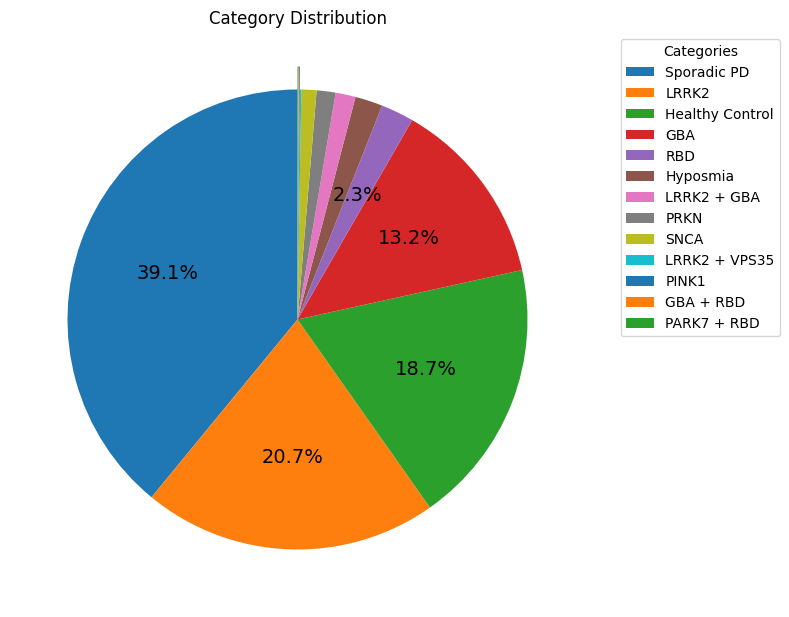

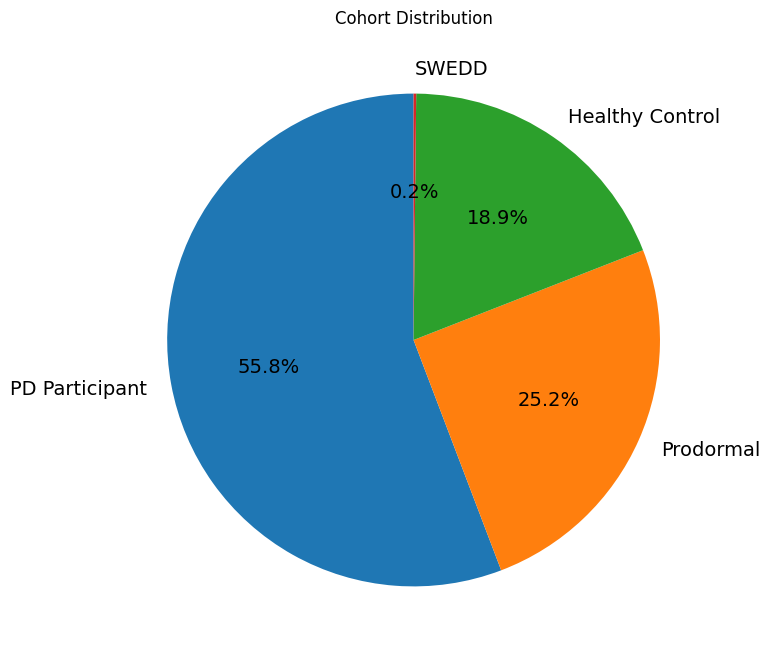

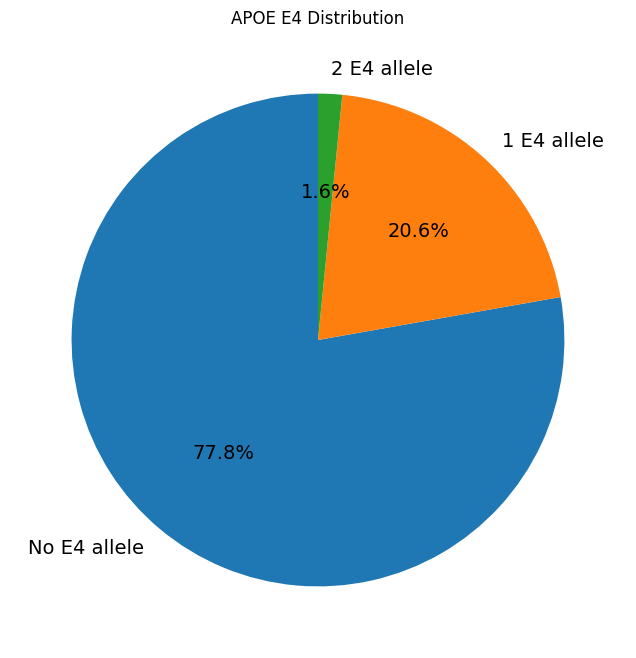

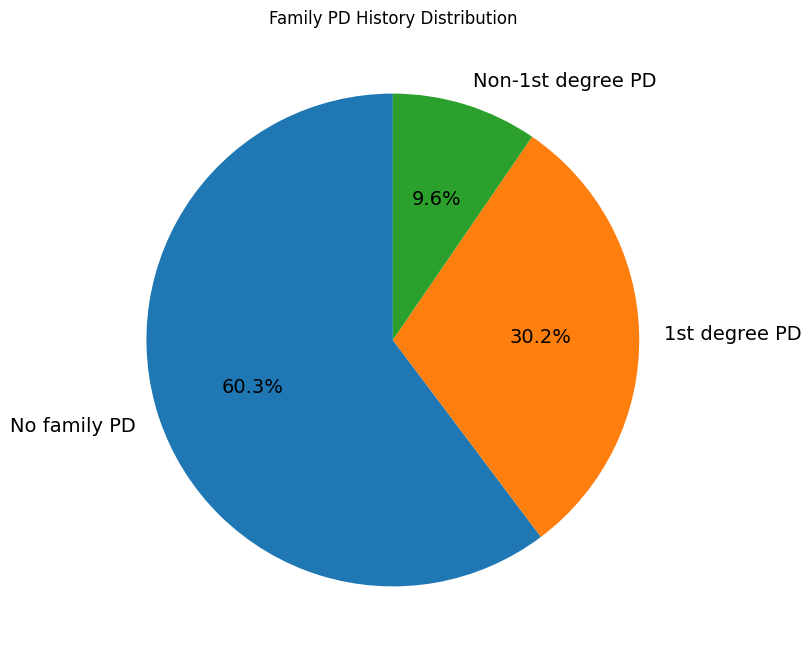

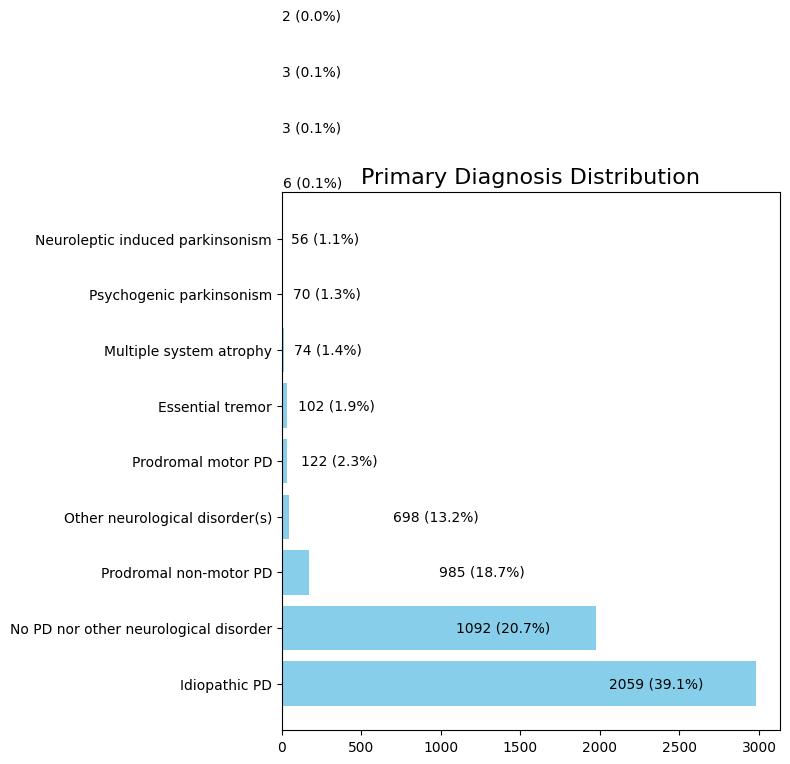

In [ ]:
# create pie charts for various categorical variables
# categorical_columns = ['COHORT', 'subgroup', 'race', 'fampd', 'APOE_e4', 'PRIMDIAG']
def autopct_format(pct):
    return f'{pct:.1f}%' if pct >= 2 else ''

data_df = pd.DataFrame(data)
subgroup_counts = data_df['subgroup'].value_counts()
category_labels = {
    1: 'GBA',
    2: 'GBA + RBD',
    3: 'Healthy Control',
    4: 'Hyposmia',
    5: 'LRRK2',
    6: 'LRRK2 + GBA',
    7: 'LRRK2 + VPS35',
    8: 'PARK7 + RBD',
    9: 'PINK1',
    10: 'PRKN',
    11: 'PRKN + RBD',
    12: 'RBD',
    13: 'SNCA',
    14: 'Sporadic PD',
}
mapped_labels = [category_labels[subgroup] for subgroup in subgroup_counts.index]
explode = [0.1 if count < 5 else 0 for count in subgroup_counts]

plt.figure(figsize=(8, 8))
plt.pie(
    subgroup_counts,
    autopct=autopct_format,
    startangle=90,
    explode=explode,
    textprops={'fontsize': 14}
)

# Add a title
plt.title('Category Distribution')

# Add the legend
plt.legend(
    mapped_labels,
    title="Categories",
    bbox_to_anchor=(1.05, 1),  # Position the legend outside the plot
    loc='upper left',
    fontsize=10
)

# Adjust layout
plt.tight_layout()
plt.show()

# ---------------------------



# ---------------------------
cohort_couonts = data_df['COHORT'].value_counts()
cohort_labels = {
    1: 'PD Participant',
    2: 'Healthy Control',
    3: 'SWEDD',
    4: 'Prodormal'

}
mapped_labels = [cohort_labels[cohort] for cohort in cohort_couonts.index]

plt.figure(figsize=(8, 8))
plt.pie(
    cohort_couonts,
    autopct='%1.1f%%',
    labels=mapped_labels,
    textprops={'fontsize': 14},
    startangle=90
)

# Add a title
plt.title('Cohort Distribution')


apoe_counts = data_df['APOE_e4'].value_counts()
apoe_labels = {
    '': 'Unknown',
    1: '1 E4 allele',
    2: '2 E4 allele',
    0: 'No E4 allele'

}
mapped_labels = [apoe_labels[apoe] for apoe in apoe_counts.index]

plt.figure(figsize=(8, 8))
plt.pie(
    apoe_counts,
    autopct='%1.1f%%',
    labels=mapped_labels,
    textprops={'fontsize': 14},
    startangle=90
)

# Add a title
plt.title('APOE E4 Distribution')

apoe_counts = data_df['fampd'].value_counts()
apoe_labels = {
    1: '1st degree PD',
    2: 'Non-1st degree PD',
    3: 'No family PD',
    '': 'Unknown'

}
mapped_labels = [apoe_labels[apoe] for apoe in apoe_counts.index]

plt.figure(figsize=(8, 8))
plt.pie(
    apoe_counts,
    autopct='%1.1f%%',
    labels=mapped_labels,
    textprops={'fontsize': 14},
    startangle=90
)

# Add a title
plt.title('Family PD History Distribution')
plt.show()


primdiag_counts = data_df['PRIMDIAG'].value_counts()
primdiag_counts = primdiag_counts[primdiag_counts >= 3]

# print(f'***** {primdiag_counts}')
primdiag_labels = {
    1: 'Idiopathic PD',
    2: 'Alzheimer\'s disease',
    3: 'Frontotemporal dementia',
    4: 'Corticobasal syndrome',
    5: 'Dementia with Lewy bodies',
    6: 'Dopa-responsive dystonia',
    7: 'Essential tremor',
    8: 'Hemiparkinson/hemiatrophy syndrome',
    9: 'Juvenile autosomal recessive parkinsonism',
    10: 'Motor neuron disease with parkinsonism',
    11: 'Multiple system atrophy',
    12: 'Neuroleptic induced parkinsonism',
    13: 'Normal pressure hydrocephalus',
    14: 'Progressive supranuclear palsy',
    15: 'Psychogenic parkinsonism',
    16: 'Vascular parkinsonism',
    17: 'No PD nor other neurological disorder',
    18: 'Spinocerebellar Ataxia (SCA)',
    23: 'Prodromal non-motor PD',
    24: 'Prodromal motor PD',
    25: 'Prodromal Synucleinopathy',
    97: 'Other neurological disorder(s)',

}
filtered_labels = {key: primdiag_labels[key] for key in primdiag_counts.index}

# Map the filtered labels
mapped_labels = [filtered_labels[primdiag] for primdiag in primdiag_counts.index]


plt.figure(figsize=(8, 8))
plt.barh(mapped_labels, primdiag_counts, color='skyblue')

# Add percentages to the bars
for index, value in enumerate(subgroup_counts):
    plt.text(value, index, f'{value} ({(value / subgroup_counts.sum()) * 100:.1f}%)',
             va='center', fontsize=10)

# Add a title
plt.title('Primary Diagnosis Distribution', fontsize=16)

# Display the plot
plt.tight_layout()
plt.show()